fine-tuning a pretrained object detection model

following tutorial: [fine-tuning pre-triained models](https://docs.pytorch.org/tutorials/intermediate/torchvision_tutorial.html)

train dataset is [1,2,3,4,5,6,7] android images
test dataset is video snapshots of android statues

The results show that training fails for the "donut" and "jellybean", so should use masks next.  TODO: add the object masks to the training.

In [1]:
import load_statues
import load_pytorch_models
import os
import sys
import torch
import numpy as np
import matplotlib.pyplot as plt
from torchvision.utils import draw_bounding_boxes, draw_segmentation_masks
import torch
from torch.utils.data import Dataset
from torchvision import tv_tensors
from torchvision.tv_tensors import BoundingBoxFormat
from torchvision.utils import draw_bounding_boxes, draw_segmentation_masks
from torchvision.io import read_image
from torchvision.ops.boxes import masks_to_boxes
from torchvision.transforms.v2 import functional as F

#add 1 to number of classes to preserve class 0, but constraints of the pretrained model
num_classes_custom = len(load_statues.class_mapping)  + 1 #9
print(f'num_classes_custom={num_classes_custom}')

num_classes_custom=10


In [2]:
model = load_pytorch_models.get_faster_rcnn(num_classes_custom)

in_features=1024


In [3]:
#model2 = load_pytorch_models.get_faster_rcnn_with_masks(num_classes_custom)

In [4]:
#putting these in bin... change as needed
module_dir = os.path.join(os.getcwd(), '..', 'bin')
sys.path.append(module_dir)
if not os.path.exists(os.path.join(module_dir, "utils.py")):
    !curl -L "https://raw.githubusercontent.com/pytorch/vision/main/references/detection/engine.py" -o ../bin/engine.py
    !curl -L "https://raw.githubusercontent.com/pytorch/vision/main/references/detection/utils.py" -o ../bin/utils.py
    !curl -L "https://raw.githubusercontent.com/pytorch/vision/main/references/detection/coco_utils.py" -o ../bin/coco_utils.py
    !curl -L "https://raw.githubusercontent.com/pytorch/vision/main/references/detection/coco_eval.py" -o ../bin/coco_eval.py
    !curl -L "https://raw.githubusercontent.com/pytorch/vision/main/references/detection/transforms.py" -o ../bin/transforms.py

import utils
from torch.utils.data import Subset
from sklearn.model_selection import train_test_split

category_index, dataset, dataset_test = load_statues.load_statues(\
    load_pytorch_models.get_transform(train=True))

#decided not to use a train/validation split
USE_VAL = False
if USE_VAL:
    #split dataset into train and validation
    def train_val_dataset(dataset, val_split=0.25):
        train_idx, val_idx = train_test_split(list(range(len(dataset))), test_size=val_split)
        return Subset(dataset, train_idx), Subset(dataset, val_idx)
    
    dataset_train, dataset_val = train_val_dataset(dataset)
    
    print(f'load data')
    data_loader_train = torch.utils.data.DataLoader(dataset_train,\
        batch_size=1,
        shuffle=False,
        collate_fn=utils.collate_fn)
    
    data_loader_val = torch.utils.data.DataLoader(dataset_val,\
        batch_size=1,
        shuffle=False,
        collate_fn=utils.collate_fn)
else:
   data_loader_train = torch.utils.data.DataLoader(dataset,\
        batch_size=1,
        shuffle=False,
        collate_fn=utils.collate_fn) 

if False:
    print(f'check inputs accepted by model')
    _images, _targets = next(iter(data_loader_train))
    _images = list(image for image in _images)
    _targets = [{k: v for k, v in t.items()} for t in _targets]
    output = model(_images, _targets)  # Returns losses and detections
    print(output)

from engine import train_one_epoch, evaluate

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.to(device)


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
       

show training dataset:


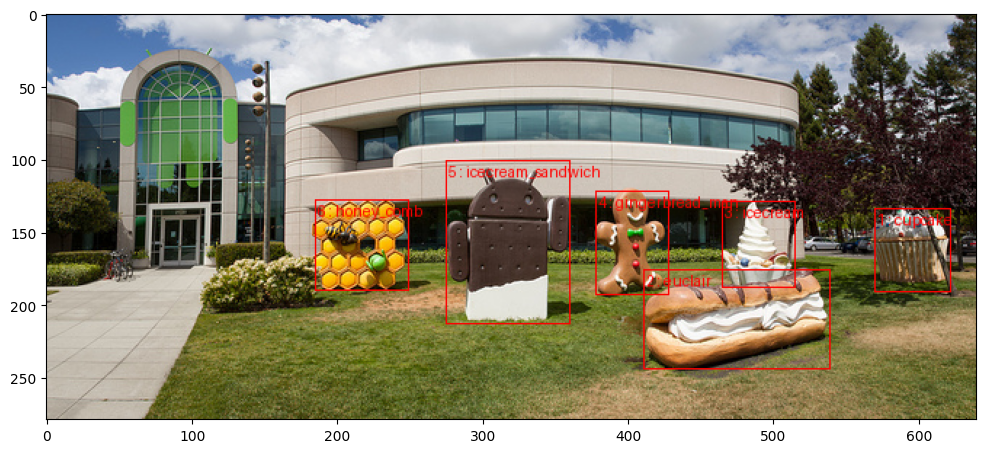

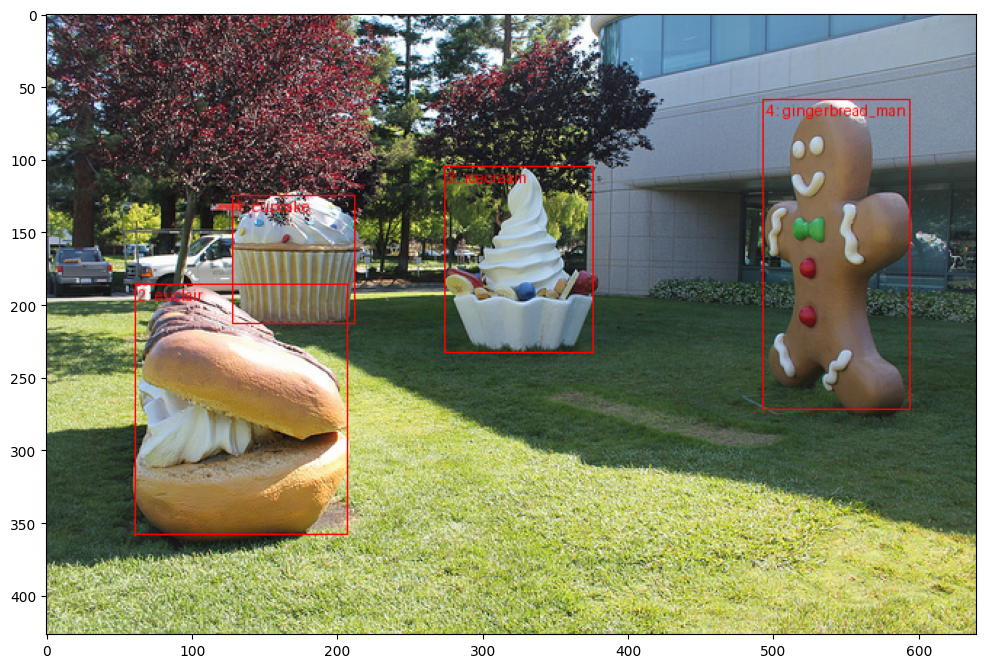

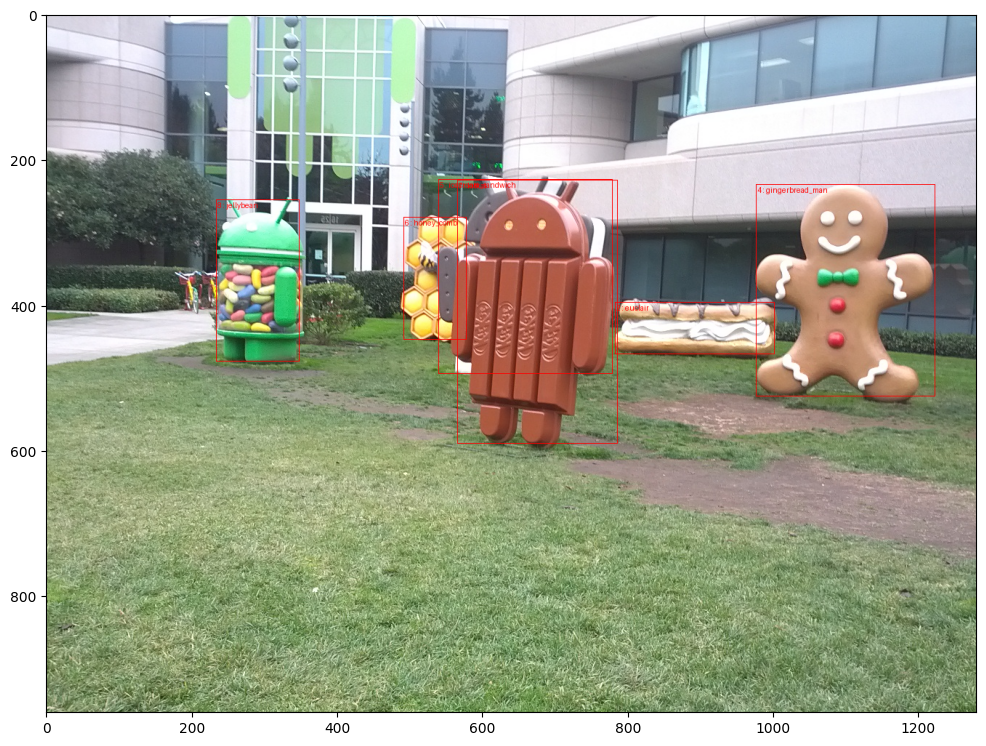

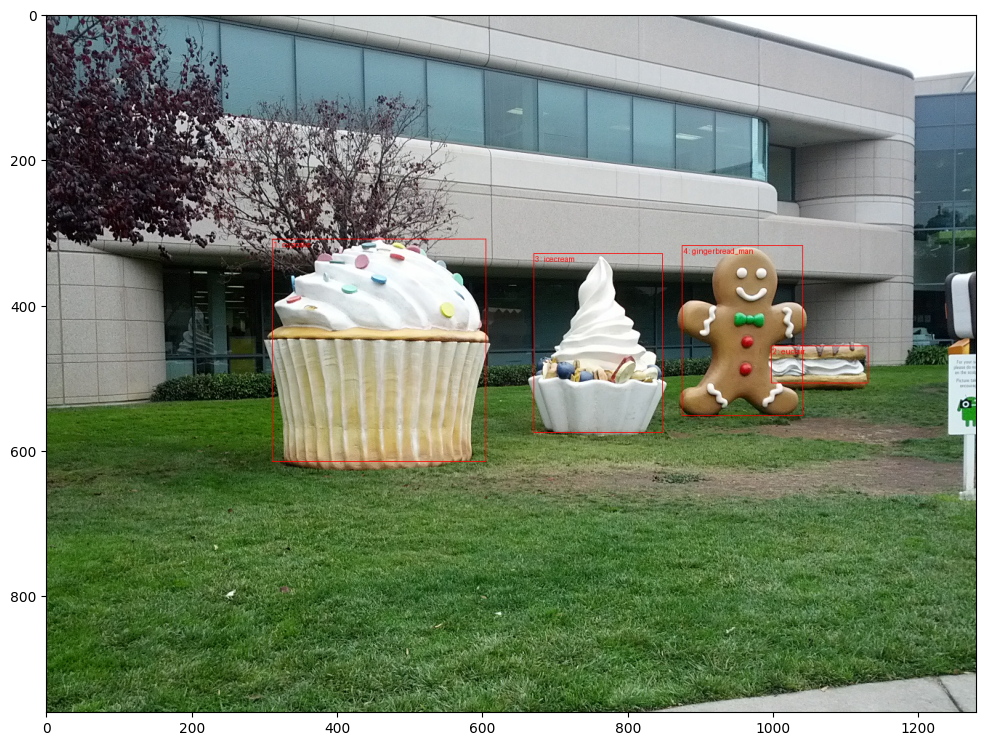

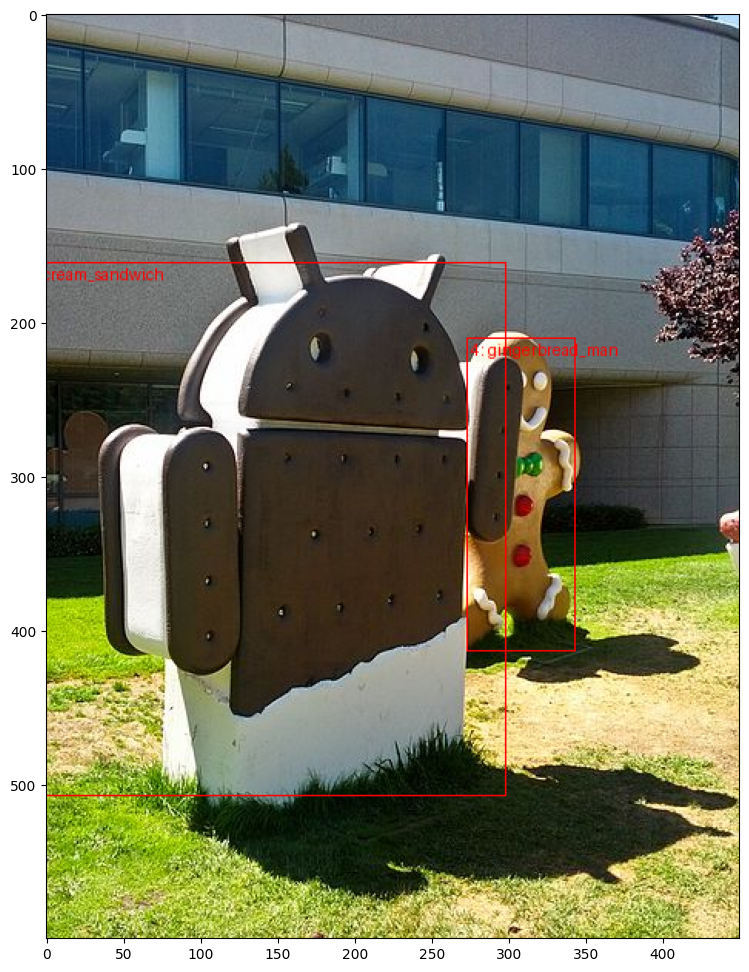

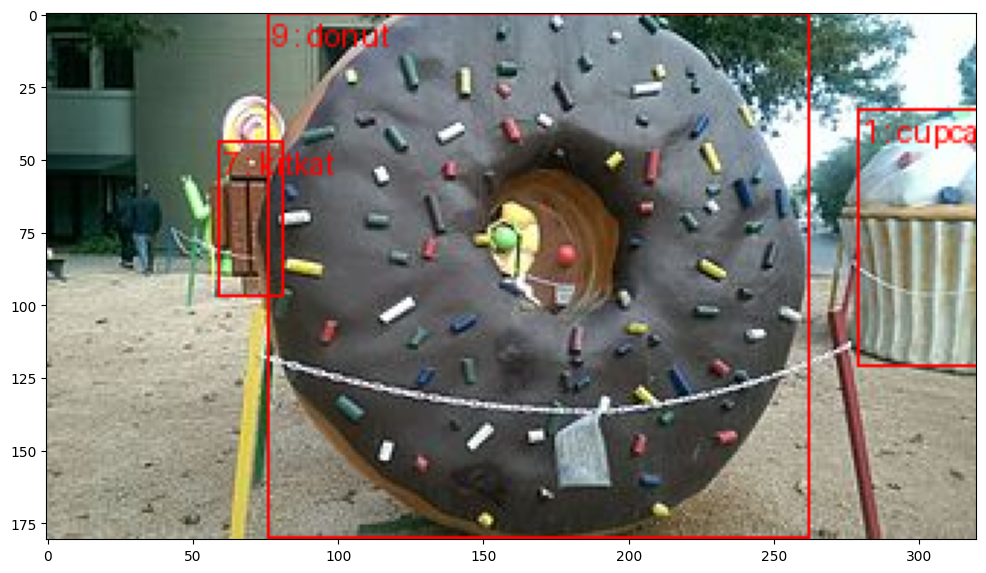

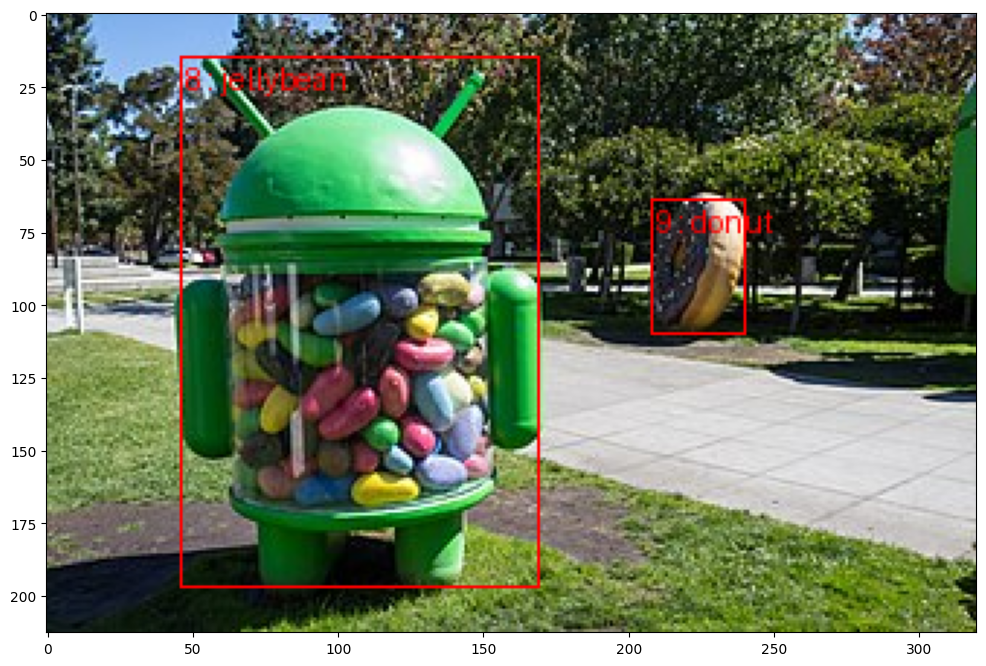

In [5]:
print(f'show training dataset:')

for images, targets in data_loader_train:
    images = [img for img in images]
    targets = [{k: v for k, v in t.items()} for t in targets]
    for img, target in zip(images, targets):
        image = (255.0 * (img - img.min()) / (img.max() - img.min())).to(torch.uint8)
        image = image[:3, ...]
        labels = [f'{_} : {category_index[_]["name"]}' for _ in target["labels"].tolist()]
        boxes = target["boxes"].long()
        output_image = draw_bounding_boxes(image, boxes, labels=labels, colors="red")
        plt.figure(figsize=(12, 12))
        plt.imshow(output_image.permute(1, 2, 0))
        plt.show()

if USE_VAL:
    print(f'show validation dataset:')
    
    for images, targets in data_loader_val:
        images = [img for img in images]
        targets = [{k: v for k, v in t.items()} for t in targets]
        for img, target in zip(images, targets):
            image = (255.0 * (img - img.min()) / (img.max() - img.min())).to(torch.uint8)
            image = image[:3, ...]
            labels = [f'{_} : {category_index[_]["name"]}' for _ in target["labels"].tolist()]
            boxes = target["boxes"].long()
            output_image = draw_bounding_boxes(image, boxes, labels=labels, colors="red")
            plt.figure(figsize=(12, 12))
            plt.imshow(output_image.permute(1, 2, 0))
            plt.show()

install the video software and sample some frames from the video

In [6]:
#load video frames to use in test
filepaths = load_statues.get_video_snapshot_filepaths()


have already downloaded YouTube mp4 file


run pre-trained model on test data before fine-tuning
labels[0]=['5: 0.240', '2: 0.238', '5: 0.234', '5: 0.225', '2: 0.223', '6: 0.219', '9: 0.217', '2: 0.216', '2: 0.214', '5: 0.212', '6: 0.212', '2: 0.212', '9: 0.208', '5: 0.203', '5: 0.202', '9: 0.201', '5: 0.200', '9: 0.200', '9: 0.198', '9: 0.198', '2: 0.197', '5: 0.196', '5: 0.195', '2: 0.195', '5: 0.195', '2: 0.195', '2: 0.195', '1: 0.194', '6: 0.193', '2: 0.190', '5: 0.189', '8: 0.189', '2: 0.188', '8: 0.187', '9: 0.187', '2: 0.186', '2: 0.186', '2: 0.186', '5: 0.186', '2: 0.185', '5: 0.185', '5: 0.184', '7: 0.184', '6: 0.184', '2: 0.181', '9: 0.181', '6: 0.180', '5: 0.180', '9: 0.180', '5: 0.179', '2: 0.178', '5: 0.178', '2: 0.177', '6: 0.177', '5: 0.177', '1: 0.176', '5: 0.176', '9: 0.176', '6: 0.176', '2: 0.176', '5: 0.176', '7: 0.175', '5: 0.175', '5: 0.174', '2: 0.174', '9: 0.174', '2: 0.174', '9: 0.174', '2: 0.173', '5: 0.173', '5: 0.173', '8: 0.173', '5: 0.172', '5: 0.172', '6: 0.171', '9: 0.171', '2: 0.171', '9: 0.170',

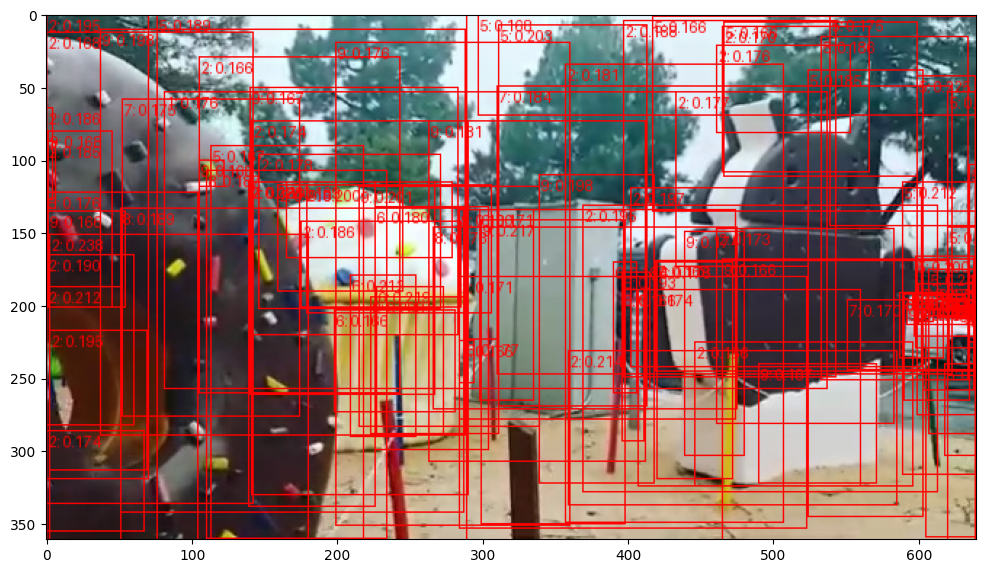

labels[1]=['5: 0.248', '2: 0.237', '2: 0.227', '5: 0.225', '5: 0.224', '2: 0.221', '5: 0.217', '2: 0.216', '5: 0.214', '5: 0.213', '5: 0.209', '2: 0.206', '8: 0.206', '5: 0.206', '2: 0.205', '7: 0.204', '5: 0.203', '8: 0.201', '6: 0.200', '7: 0.198', '2: 0.198', '2: 0.197', '5: 0.196', '5: 0.196', '2: 0.195', '5: 0.193', '8: 0.193', '2: 0.193', '2: 0.191', '9: 0.189', '9: 0.188', '9: 0.188', '5: 0.188', '5: 0.188', '5: 0.187', '7: 0.187', '5: 0.187', '1: 0.186', '2: 0.185', '2: 0.184', '9: 0.182', '8: 0.181', '6: 0.181', '2: 0.181', '9: 0.180', '9: 0.179', '2: 0.179', '9: 0.178', '9: 0.178', '2: 0.177', '1: 0.175', '5: 0.175', '8: 0.175', '6: 0.175', '9: 0.174', '2: 0.174', '2: 0.174', '9: 0.174', '8: 0.173', '6: 0.173', '9: 0.172', '9: 0.172', '9: 0.171', '5: 0.171', '6: 0.171', '2: 0.169', '4: 0.168', '5: 0.168', '5: 0.168', '5: 0.168', '5: 0.168', '9: 0.168', '9: 0.167', '5: 0.167', '2: 0.166', '5: 0.166', '5: 0.166', '9: 0.166', '5: 0.166', '5: 0.166', '2: 0.166', '7: 0.165', '5: 0

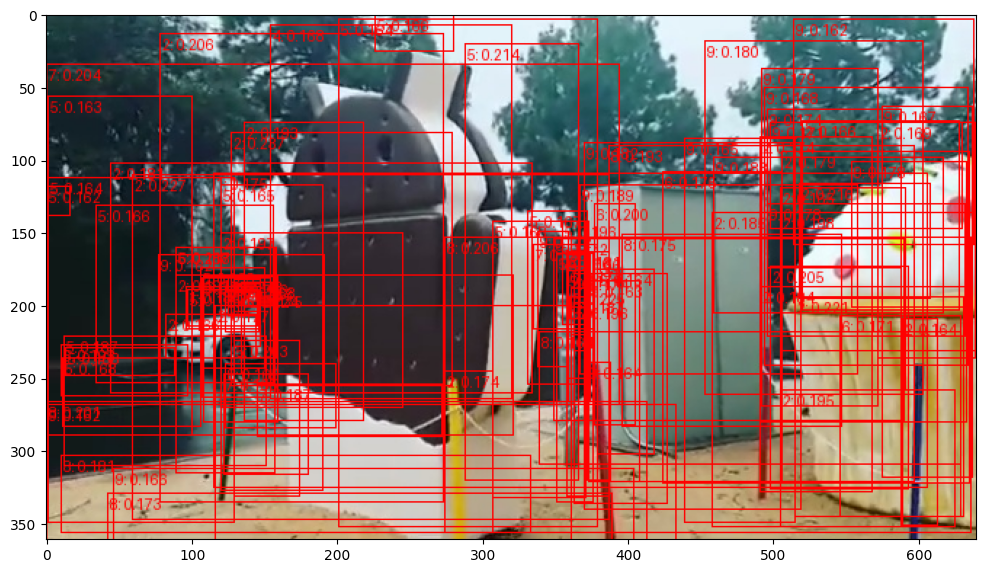

labels[2]=['5: 0.298', '2: 0.267', '5: 0.265', '2: 0.263', '5: 0.259', '5: 0.242', '2: 0.237', '5: 0.232', '5: 0.225', '9: 0.225', '5: 0.222', '6: 0.221', '5: 0.220', '5: 0.217', '8: 0.216', '5: 0.211', '5: 0.210', '5: 0.210', '5: 0.204', '6: 0.203', '2: 0.203', '5: 0.202', '5: 0.202', '6: 0.202', '2: 0.198', '6: 0.198', '8: 0.198', '5: 0.196', '9: 0.196', '9: 0.195', '9: 0.194', '5: 0.192', '9: 0.192', '6: 0.189', '9: 0.189', '6: 0.189', '9: 0.189', '5: 0.188', '5: 0.186', '2: 0.186', '2: 0.186', '2: 0.185', '6: 0.184', '5: 0.184', '6: 0.184', '5: 0.183', '5: 0.183', '5: 0.183', '5: 0.183', '9: 0.183', '9: 0.183', '2: 0.182', '6: 0.182', '5: 0.182', '5: 0.182', '5: 0.181', '9: 0.180', '5: 0.180', '5: 0.179', '5: 0.179', '5: 0.179', '5: 0.178', '9: 0.178', '2: 0.178', '9: 0.177', '5: 0.177', '8: 0.177', '2: 0.175', '5: 0.175', '8: 0.175', '9: 0.174', '9: 0.174', '9: 0.174', '6: 0.173', '9: 0.173', '5: 0.173', '9: 0.172', '2: 0.171', '9: 0.171', '8: 0.171', '1: 0.171', '5: 0.171', '5: 0

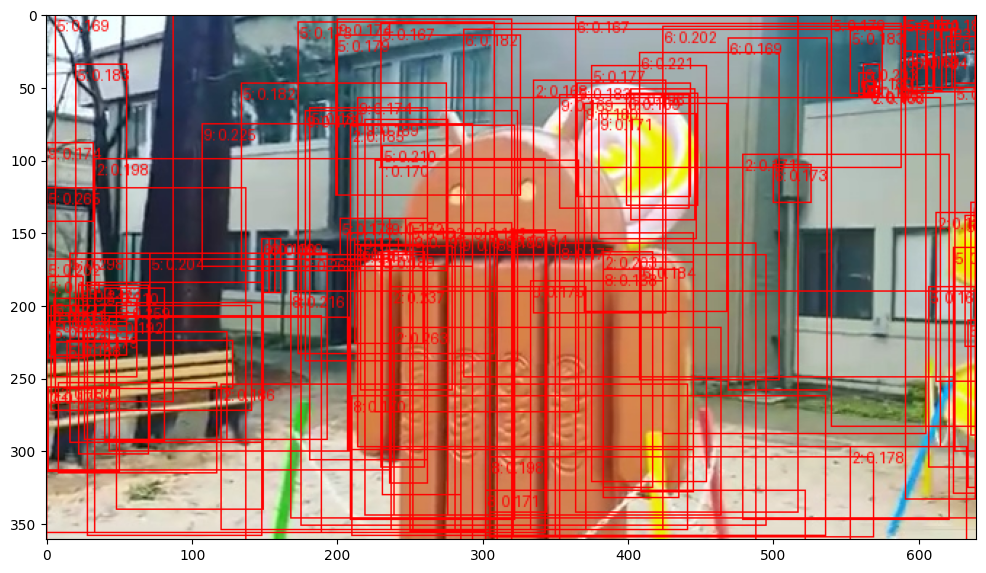

labels[3]=['5: 0.254', '5: 0.252', '2: 0.247', '9: 0.237', '9: 0.225', '2: 0.224', '8: 0.223', '5: 0.223', '2: 0.220', '6: 0.220', '5: 0.218', '8: 0.218', '5: 0.216', '2: 0.214', '9: 0.214', '2: 0.212', '2: 0.210', '9: 0.207', '9: 0.206', '5: 0.205', '2: 0.203', '5: 0.200', '2: 0.200', '6: 0.198', '5: 0.198', '6: 0.197', '2: 0.194', '5: 0.193', '9: 0.193', '5: 0.192', '5: 0.192', '2: 0.191', '1: 0.191', '6: 0.191', '9: 0.190', '6: 0.189', '5: 0.189', '2: 0.188', '9: 0.188', '5: 0.187', '1: 0.185', '9: 0.184', '5: 0.183', '9: 0.183', '6: 0.183', '5: 0.183', '5: 0.182', '2: 0.182', '6: 0.181', '5: 0.181', '5: 0.181', '5: 0.181', '5: 0.180', '5: 0.180', '2: 0.180', '2: 0.180', '2: 0.179', '5: 0.179', '6: 0.179', '5: 0.178', '5: 0.178', '6: 0.178', '2: 0.177', '6: 0.177', '6: 0.177', '8: 0.177', '5: 0.175', '5: 0.175', '9: 0.175', '9: 0.175', '2: 0.175', '5: 0.174', '5: 0.174', '6: 0.172', '9: 0.172', '5: 0.172', '2: 0.172', '9: 0.171', '1: 0.171', '9: 0.171', '2: 0.171', '2: 0.171', '2: 0

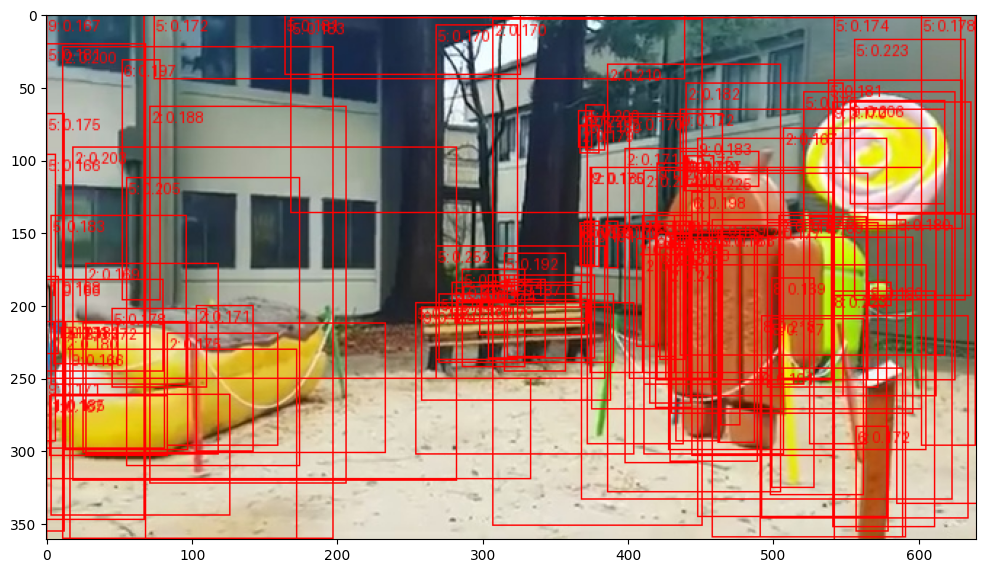

labels[4]=['5: 0.272', '5: 0.252', '5: 0.251', '5: 0.222', '5: 0.222', '5: 0.221', '5: 0.219', '9: 0.212', '5: 0.211', '9: 0.211', '9: 0.210', '5: 0.208', '2: 0.208', '6: 0.207', '5: 0.206', '9: 0.206', '6: 0.206', '9: 0.200', '5: 0.199', '9: 0.199', '1: 0.197', '5: 0.194', '9: 0.194', '5: 0.193', '6: 0.192', '9: 0.192', '9: 0.191', '1: 0.185', '2: 0.185', '6: 0.184', '9: 0.183', '9: 0.183', '9: 0.183', '9: 0.182', '9: 0.181', '5: 0.181', '6: 0.180', '9: 0.180', '5: 0.180', '5: 0.180', '9: 0.179', '9: 0.179', '9: 0.178', '5: 0.178', '5: 0.177', '5: 0.177', '9: 0.177', '5: 0.176', '9: 0.174', '5: 0.174', '9: 0.173', '6: 0.173', '9: 0.173', '9: 0.171', '9: 0.171', '6: 0.171', '2: 0.171', '9: 0.171', '9: 0.171', '5: 0.170', '9: 0.170', '5: 0.169', '6: 0.169', '9: 0.169', '9: 0.169', '5: 0.168', '6: 0.168', '1: 0.167', '5: 0.167', '9: 0.167', '5: 0.167', '4: 0.167', '2: 0.166', '1: 0.166', '2: 0.166', '9: 0.166', '6: 0.166', '5: 0.166', '5: 0.165', '5: 0.165', '2: 0.165', '1: 0.164', '9: 0

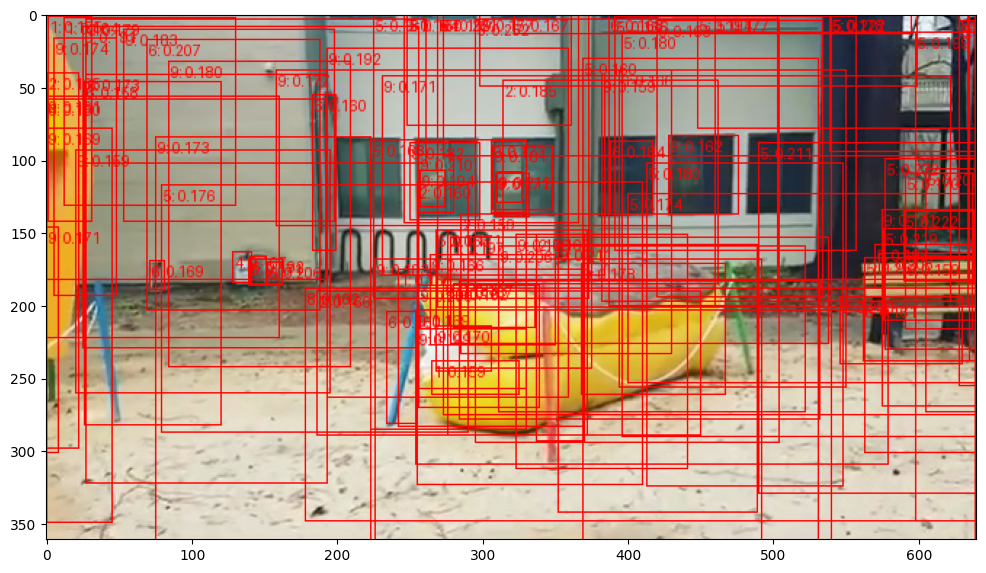

labels[5]=['2: 0.277', '2: 0.263', '2: 0.239', '2: 0.226', '2: 0.221', '2: 0.221', '2: 0.216', '2: 0.212', '1: 0.208', '2: 0.207', '5: 0.203', '5: 0.200', '5: 0.199', '5: 0.196', '7: 0.196', '9: 0.195', '9: 0.192', '9: 0.189', '9: 0.188', '8: 0.188', '5: 0.188', '1: 0.188', '5: 0.187', '8: 0.186', '5: 0.186', '2: 0.185', '6: 0.185', '2: 0.182', '5: 0.182', '7: 0.181', '6: 0.180', '9: 0.180', '5: 0.180', '7: 0.179', '9: 0.179', '5: 0.178', '5: 0.178', '6: 0.178', '6: 0.178', '2: 0.177', '6: 0.177', '6: 0.177', '5: 0.176', '5: 0.176', '9: 0.176', '2: 0.175', '2: 0.175', '5: 0.175', '9: 0.174', '5: 0.174', '2: 0.174', '5: 0.173', '8: 0.173', '9: 0.173', '5: 0.173', '2: 0.172', '5: 0.172', '8: 0.172', '5: 0.172', '2: 0.172', '2: 0.172', '5: 0.172', '5: 0.171', '9: 0.171', '2: 0.171', '1: 0.171', '2: 0.170', '9: 0.170', '2: 0.169', '2: 0.169', '5: 0.169', '2: 0.169', '1: 0.168', '9: 0.168', '5: 0.167', '9: 0.167', '2: 0.166', '5: 0.166', '9: 0.166', '9: 0.166', '9: 0.166', '5: 0.165', '9: 0

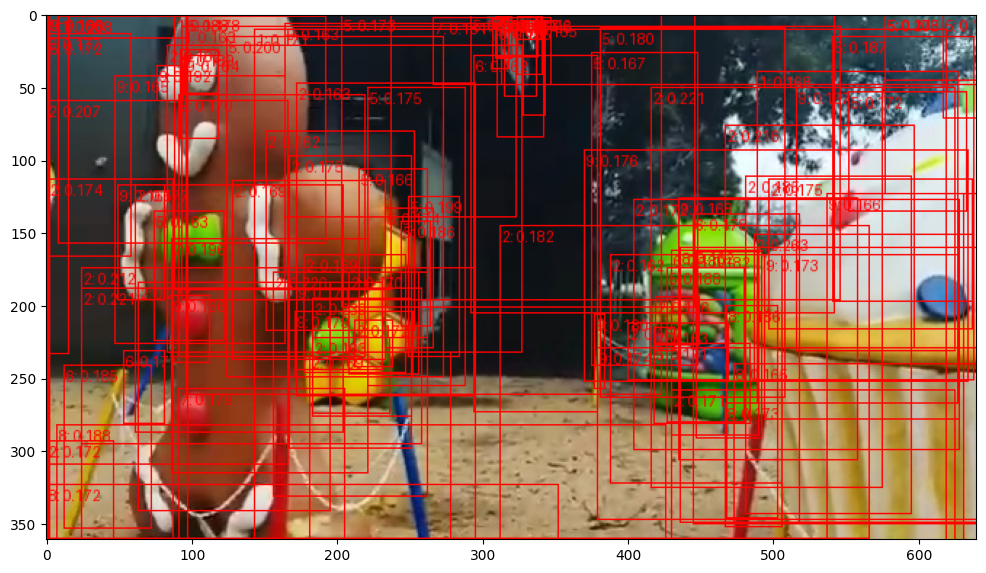

labels[6]=['2: 0.265', '2: 0.236', '2: 0.230', '2: 0.228', '2: 0.222', '2: 0.219', '6: 0.216', '9: 0.214', '5: 0.211', '2: 0.209', '2: 0.208', '5: 0.206', '2: 0.205', '5: 0.205', '6: 0.203', '8: 0.201', '2: 0.198', '2: 0.194', '9: 0.193', '5: 0.192', '5: 0.190', '2: 0.189', '2: 0.188', '5: 0.187', '9: 0.187', '6: 0.187', '2: 0.186', '4: 0.186', '6: 0.185', '5: 0.185', '2: 0.184', '5: 0.184', '2: 0.183', '5: 0.183', '5: 0.182', '5: 0.181', '5: 0.180', '5: 0.180', '5: 0.179', '5: 0.179', '8: 0.179', '9: 0.178', '5: 0.178', '5: 0.177', '6: 0.176', '2: 0.176', '6: 0.175', '2: 0.175', '6: 0.174', '6: 0.174', '5: 0.174', '5: 0.173', '4: 0.173', '2: 0.173', '2: 0.173', '6: 0.173', '5: 0.172', '9: 0.172', '5: 0.171', '9: 0.171', '6: 0.170', '9: 0.170', '5: 0.170', '6: 0.169', '2: 0.168', '5: 0.168', '6: 0.168', '8: 0.168', '2: 0.168', '8: 0.167', '8: 0.167', '9: 0.167', '5: 0.166', '2: 0.166', '1: 0.166', '6: 0.165', '5: 0.165', '2: 0.165', '6: 0.164', '4: 0.164', '8: 0.164', '2: 0.163', '2: 0

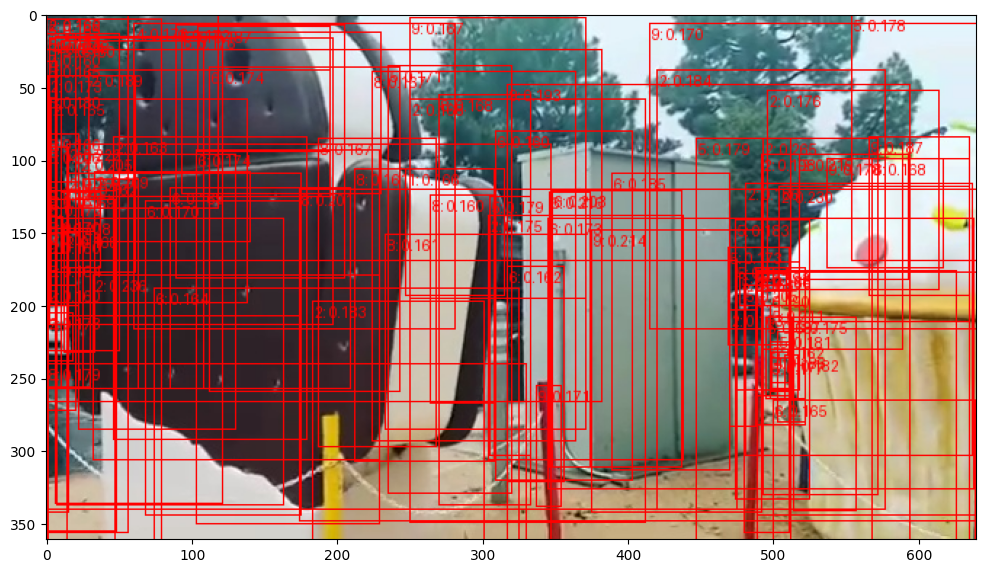

labels[7]=['2: 0.274', '2: 0.260', '2: 0.253', '2: 0.253', '2: 0.237', '2: 0.227', '9: 0.225', '6: 0.225', '2: 0.224', '6: 0.223', '5: 0.222', '9: 0.216', '6: 0.210', '2: 0.209', '2: 0.208', '5: 0.205', '9: 0.203', '2: 0.202', '2: 0.201', '2: 0.200', '2: 0.200', '5: 0.198', '5: 0.197', '5: 0.197', '2: 0.195', '2: 0.195', '9: 0.194', '9: 0.193', '5: 0.193', '1: 0.193', '2: 0.191', '2: 0.190', '9: 0.190', '2: 0.190', '2: 0.189', '5: 0.188', '6: 0.188', '2: 0.188', '2: 0.187', '1: 0.186', '5: 0.185', '2: 0.185', '2: 0.184', '9: 0.184', '6: 0.184', '6: 0.183', '9: 0.182', '2: 0.182', '9: 0.182', '1: 0.182', '1: 0.181', '9: 0.180', '5: 0.180', '6: 0.180', '2: 0.179', '5: 0.179', '2: 0.178', '9: 0.178', '9: 0.177', '9: 0.177', '9: 0.177', '5: 0.177', '2: 0.176', '6: 0.176', '2: 0.176', '6: 0.175', '2: 0.175', '6: 0.175', '6: 0.174', '5: 0.174', '2: 0.174', '5: 0.174', '5: 0.173', '5: 0.173', '9: 0.173', '5: 0.172', '4: 0.171', '2: 0.171', '9: 0.171', '5: 0.171', '5: 0.171', '8: 0.171', '6: 0

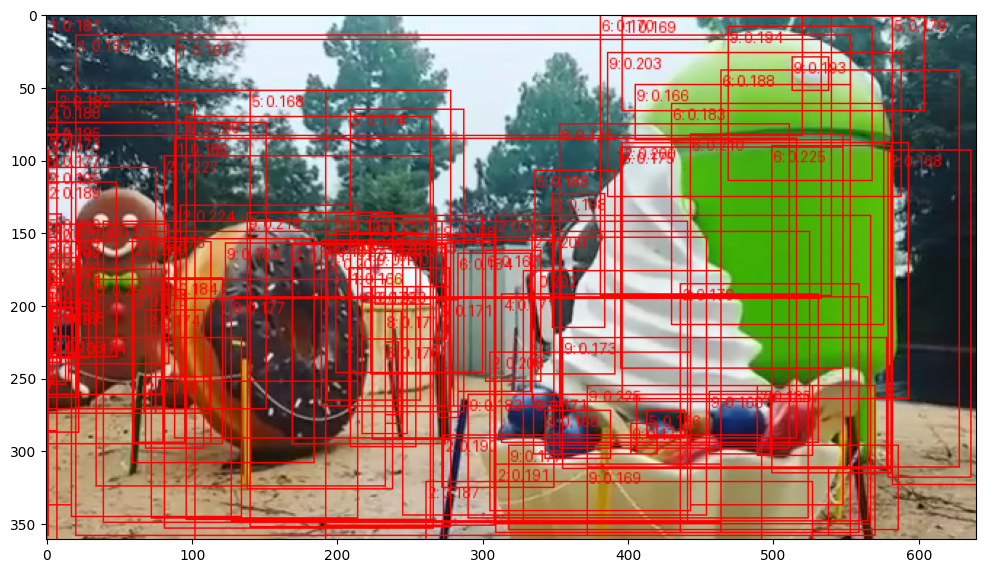

labels[8]=['2: 0.329', '5: 0.263', '2: 0.254', '2: 0.253', '2: 0.244', '2: 0.236', '6: 0.234', '7: 0.229', '6: 0.226', '9: 0.223', '2: 0.219', '9: 0.218', '2: 0.218', '9: 0.217', '9: 0.211', '2: 0.211', '2: 0.210', '2: 0.205', '9: 0.205', '5: 0.204', '1: 0.203', '2: 0.202', '9: 0.202', '9: 0.202', '9: 0.201', '9: 0.200', '9: 0.200', '5: 0.199', '2: 0.196', '9: 0.194', '2: 0.193', '7: 0.191', '9: 0.191', '5: 0.190', '9: 0.190', '9: 0.189', '9: 0.189', '9: 0.188', '2: 0.188', '1: 0.187', '7: 0.187', '2: 0.185', '9: 0.185', '9: 0.185', '7: 0.185', '5: 0.185', '9: 0.185', '5: 0.184', '9: 0.184', '5: 0.183', '1: 0.183', '9: 0.183', '5: 0.182', '9: 0.182', '9: 0.181', '1: 0.181', '9: 0.180', '5: 0.180', '9: 0.180', '9: 0.180', '9: 0.179', '9: 0.179', '6: 0.179', '2: 0.178', '5: 0.178', '3: 0.178', '2: 0.178', '9: 0.178', '6: 0.178', '9: 0.178', '5: 0.177', '9: 0.176', '9: 0.175', '9: 0.175', '2: 0.175', '1: 0.175', '2: 0.175', '2: 0.174', '1: 0.174', '8: 0.173', '5: 0.173', '9: 0.172', '9: 0

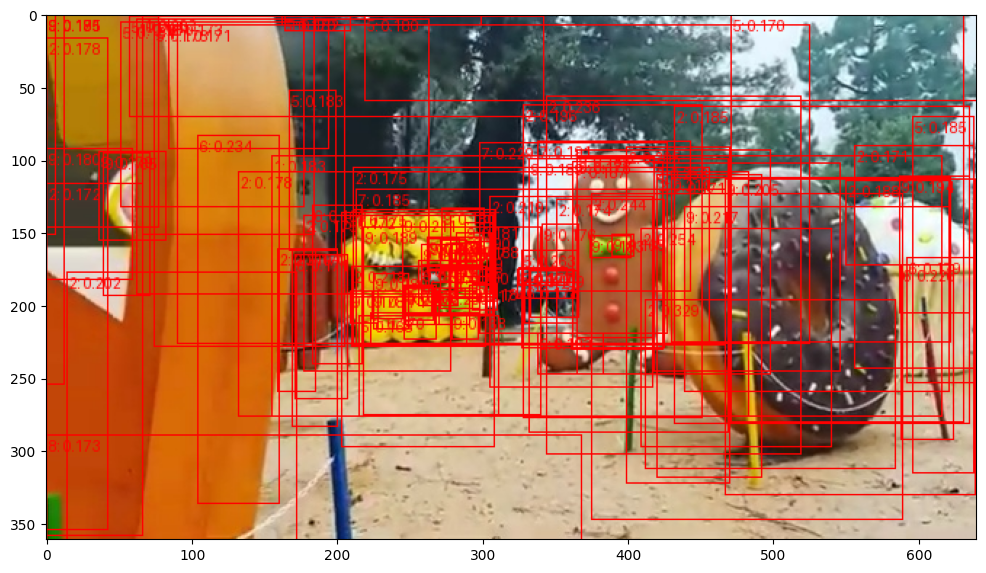

labels[9]=['2: 0.291', '2: 0.276', '2: 0.265', '2: 0.263', '2: 0.234', '9: 0.229', '2: 0.229', '2: 0.228', '2: 0.223', '6: 0.221', '9: 0.219', '2: 0.217', '9: 0.213', '5: 0.212', '2: 0.211', '2: 0.210', '5: 0.207', '6: 0.204', '6: 0.204', '9: 0.203', '2: 0.203', '6: 0.201', '2: 0.201', '9: 0.200', '5: 0.199', '2: 0.199', '2: 0.199', '9: 0.198', '2: 0.198', '9: 0.197', '5: 0.197', '7: 0.196', '9: 0.195', '2: 0.195', '2: 0.195', '1: 0.195', '9: 0.194', '6: 0.192', '6: 0.192', '6: 0.191', '2: 0.189', '2: 0.188', '2: 0.187', '6: 0.186', '9: 0.186', '5: 0.186', '9: 0.186', '9: 0.185', '1: 0.185', '5: 0.184', '2: 0.184', '1: 0.184', '1: 0.184', '2: 0.184', '2: 0.184', '2: 0.183', '9: 0.183', '5: 0.183', '9: 0.183', '1: 0.182', '9: 0.182', '2: 0.181', '2: 0.180', '2: 0.180', '9: 0.180', '5: 0.180', '9: 0.178', '9: 0.178', '9: 0.178', '5: 0.177', '9: 0.176', '2: 0.176', '1: 0.176', '2: 0.176', '6: 0.176', '5: 0.176', '6: 0.175', '9: 0.175', '2: 0.174', '2: 0.174', '5: 0.174', '1: 0.173', '5: 0

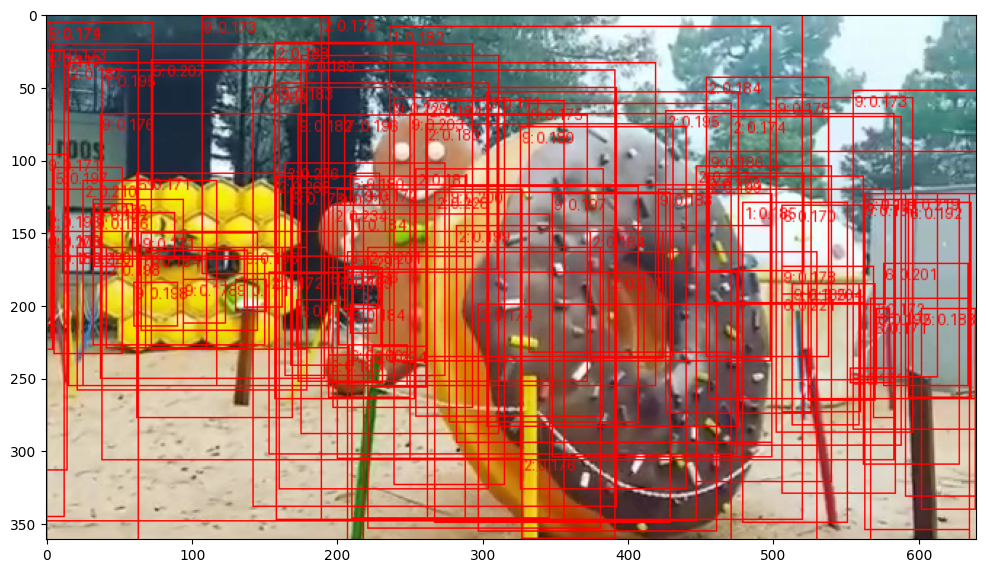

labels[10]=['9: 0.235', '5: 0.210', '9: 0.209', '6: 0.209', '2: 0.209', '9: 0.208', '9: 0.208', '6: 0.207', '5: 0.207', '6: 0.204', '2: 0.204', '5: 0.203', '2: 0.202', '9: 0.202', '5: 0.201', '6: 0.200', '9: 0.200', '2: 0.200', '9: 0.199', '9: 0.198', '6: 0.198', '9: 0.196', '2: 0.195', '6: 0.194', '9: 0.193', '2: 0.191', '6: 0.190', '9: 0.190', '6: 0.189', '6: 0.188', '6: 0.186', '5: 0.185', '9: 0.185', '8: 0.185', '9: 0.185', '2: 0.185', '6: 0.184', '9: 0.184', '9: 0.184', '2: 0.183', '5: 0.183', '9: 0.183', '9: 0.183', '9: 0.182', '5: 0.182', '5: 0.181', '2: 0.181', '5: 0.181', '1: 0.181', '2: 0.181', '9: 0.180', '5: 0.180', '9: 0.180', '7: 0.180', '8: 0.179', '6: 0.179', '5: 0.179', '5: 0.179', '9: 0.178', '9: 0.177', '5: 0.177', '9: 0.177', '6: 0.176', '6: 0.176', '1: 0.176', '6: 0.176', '6: 0.176', '9: 0.175', '6: 0.175', '9: 0.174', '9: 0.174', '1: 0.174', '9: 0.173', '8: 0.173', '9: 0.173', '6: 0.173', '7: 0.173', '5: 0.172', '6: 0.172', '6: 0.171', '9: 0.171', '2: 0.171', '9: 

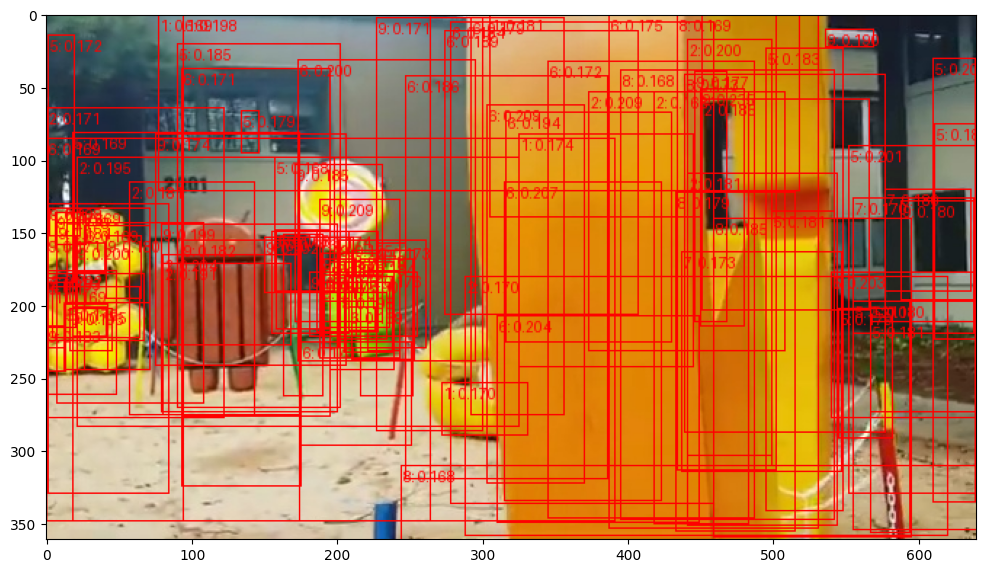

labels[11]=['2: 0.289', '2: 0.238', '9: 0.236', '2: 0.229', '9: 0.227', '9: 0.223', '9: 0.220', '4: 0.216', '9: 0.216', '9: 0.215', '2: 0.213', '9: 0.213', '6: 0.210', '9: 0.209', '5: 0.209', '7: 0.208', '9: 0.207', '2: 0.207', '2: 0.206', '5: 0.205', '9: 0.204', '2: 0.204', '9: 0.203', '6: 0.201', '2: 0.201', '5: 0.200', '9: 0.200', '2: 0.199', '2: 0.197', '2: 0.193', '9: 0.193', '9: 0.192', '9: 0.192', '8: 0.192', '2: 0.191', '2: 0.191', '2: 0.190', '6: 0.190', '9: 0.189', '9: 0.189', '1: 0.188', '5: 0.188', '9: 0.187', '9: 0.186', '9: 0.186', '2: 0.185', '6: 0.184', '6: 0.184', '9: 0.184', '2: 0.183', '8: 0.183', '9: 0.182', '1: 0.182', '9: 0.182', '9: 0.182', '9: 0.182', '7: 0.182', '2: 0.181', '2: 0.180', '9: 0.180', '2: 0.180', '9: 0.180', '2: 0.180', '6: 0.179', '6: 0.179', '5: 0.179', '9: 0.178', '9: 0.177', '9: 0.177', '9: 0.177', '5: 0.177', '2: 0.177', '9: 0.176', '2: 0.176', '9: 0.176', '9: 0.176', '4: 0.175', '5: 0.175', '9: 0.175', '6: 0.175', '5: 0.175', '9: 0.174', '9: 

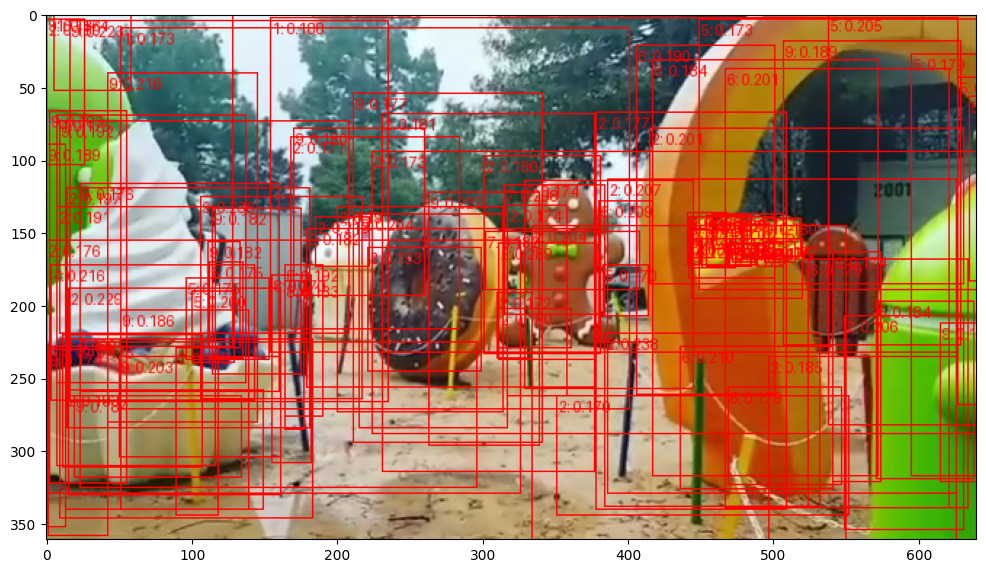

labels[12]=['2: 0.258', '2: 0.232', '6: 0.229', '5: 0.226', '2: 0.221', '2: 0.216', '9: 0.214', '2: 0.213', '6: 0.212', '2: 0.209', '9: 0.206', '2: 0.204', '9: 0.200', '9: 0.199', '7: 0.198', '5: 0.197', '9: 0.196', '9: 0.196', '6: 0.194', '1: 0.194', '5: 0.193', '5: 0.193', '2: 0.192', '5: 0.191', '5: 0.190', '6: 0.190', '8: 0.189', '2: 0.189', '2: 0.189', '5: 0.189', '6: 0.189', '5: 0.188', '9: 0.188', '5: 0.188', '9: 0.188', '2: 0.188', '5: 0.188', '6: 0.187', '9: 0.187', '8: 0.187', '2: 0.186', '2: 0.186', '9: 0.186', '5: 0.185', '2: 0.184', '2: 0.183', '5: 0.183', '6: 0.183', '9: 0.183', '5: 0.183', '1: 0.182', '9: 0.181', '2: 0.181', '9: 0.181', '6: 0.181', '6: 0.181', '5: 0.181', '9: 0.180', '9: 0.180', '9: 0.180', '8: 0.180', '6: 0.179', '5: 0.178', '6: 0.178', '1: 0.178', '2: 0.177', '5: 0.177', '5: 0.176', '9: 0.176', '2: 0.176', '2: 0.176', '9: 0.175', '4: 0.175', '4: 0.175', '5: 0.174', '6: 0.174', '6: 0.174', '9: 0.174', '6: 0.174', '2: 0.174', '1: 0.174', '9: 0.173', '9: 

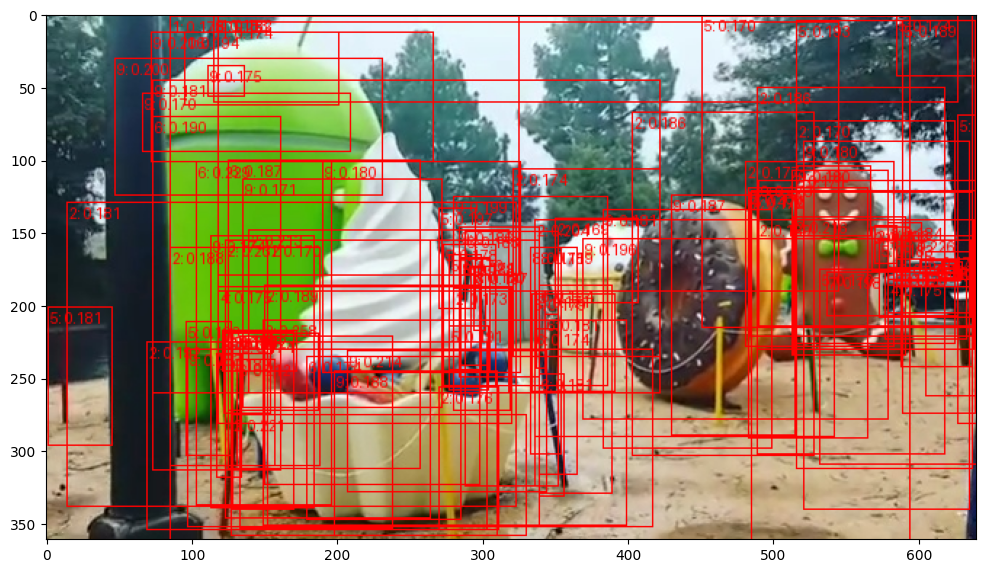

labels[13]=['6: 0.269', '5: 0.259', '5: 0.250', '9: 0.243', '6: 0.243', '2: 0.234', '2: 0.233', '2: 0.232', '2: 0.232', '6: 0.226', '9: 0.223', '2: 0.213', '1: 0.213', '5: 0.213', '5: 0.212', '9: 0.209', '9: 0.209', '9: 0.208', '9: 0.203', '5: 0.203', '5: 0.200', '6: 0.200', '2: 0.200', '5: 0.199', '9: 0.199', '9: 0.199', '9: 0.198', '2: 0.197', '2: 0.197', '5: 0.197', '9: 0.197', '2: 0.196', '5: 0.195', '9: 0.193', '5: 0.193', '6: 0.193', '9: 0.190', '9: 0.190', '9: 0.190', '1: 0.189', '6: 0.189', '5: 0.189', '9: 0.187', '5: 0.187', '9: 0.187', '9: 0.187', '8: 0.186', '1: 0.185', '5: 0.184', '1: 0.184', '6: 0.184', '5: 0.184', '2: 0.184', '9: 0.184', '9: 0.183', '6: 0.182', '5: 0.182', '9: 0.182', '9: 0.182', '2: 0.181', '9: 0.181', '6: 0.180', '3: 0.180', '5: 0.180', '9: 0.179', '8: 0.179', '1: 0.179', '1: 0.179', '9: 0.178', '9: 0.178', '9: 0.178', '5: 0.178', '6: 0.178', '1: 0.178', '9: 0.177', '3: 0.177', '6: 0.177', '9: 0.176', '6: 0.176', '5: 0.175', '7: 0.174', '2: 0.174', '7: 

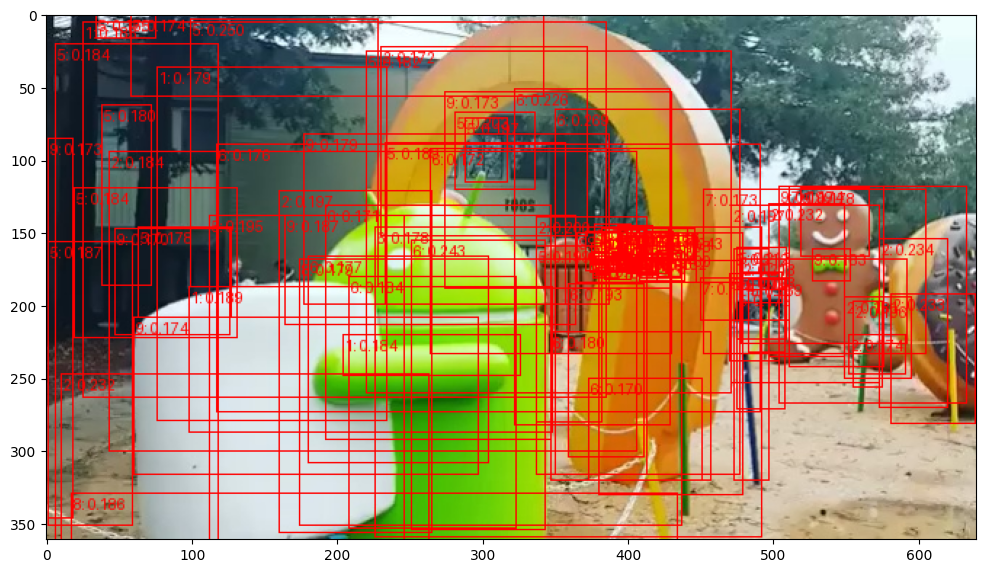

begin fine-tuning
Epoch: 0, Loss: 3.027864933013916
Epoch: 0, Loss: 2.262817621231079
Epoch: 0, Loss: 2.150707960128784
Epoch: 0, Loss: 1.630942702293396
Epoch: 0, Loss: 1.1729289293289185
Epoch: 0, Loss: 0.9783132672309875
Epoch: 0, Loss: 0.6384479999542236
Epoch: 0, Train loss: 1.694574773311615
Epoch: 1, Loss: 1.6040962934494019
Epoch: 1, Loss: 0.9623299241065979
Epoch: 1, Loss: 1.1967532634735107
Epoch: 1, Loss: 0.8987210988998413
Epoch: 1, Loss: 0.6115707755088806
Epoch: 1, Loss: 0.628856897354126
Epoch: 1, Loss: 0.4558049440383911
Epoch: 1, Train loss: 0.9083047424043927
Epoch: 2, Loss: 1.4926056861877441
Epoch: 2, Loss: 0.937874436378479
Epoch: 2, Loss: 1.332690954208374
Epoch: 2, Loss: 0.8269981741905212
Epoch: 2, Loss: 0.4342186748981476
Epoch: 2, Loss: 0.6274756789207458
Epoch: 2, Loss: 0.3497689962387085
Epoch: 2, Train loss: 0.8573760858603886
Epoch: 3, Loss: 1.3335909843444824
Epoch: 3, Loss: 0.7139461040496826
Epoch: 3, Loss: 1.181384801864624
Epoch: 3, Loss: 0.6551387310

In [7]:
transforms = load_pytorch_models.get_transform(train=True)

# check test results w/o training
%matplotlib inline
print('run pre-trained model on test data before fine-tuning')
model.eval()
with torch.no_grad():
    j = 0
    for filepath in filepaths:
        image = tv_tensors.Image(read_image(filepath))
        image = transforms(image)
        images = [image.to(device)]
        # Forward pass
        prediction = model(images)
        for img in images:
            image = (255.0 * (img - img.min()) / (img.max() - img.min())).to(torch.uint8)
            image = image[:3, ...]
            pred_labels = [f"{label}: {score:.3f}" for label, score in zip(prediction[0]["labels"], prediction[0]["scores"])]
            pred_boxes = prediction[0]["boxes"].long()
            output_image = draw_bounding_boxes(image, pred_boxes, pred_labels, colors="red")
            plt.figure(figsize=(12, 12))
            plt.imshow(output_image.permute(1, 2, 0))
            print(f'labels[{j}]={pred_labels}')
            plt.show()
        j+=1

print('begin fine-tuning')

learning_rate = 0.001
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.Adam(params, lr=learning_rate)

early_stopping = load_pytorch_models.EarlyStopping(patience=3, delta=0.01, verbose=True)

epochs = 10

for epoch in range(epochs):
    train_loss = 0.0
    val_loss = 0.0
    model.train()
    for images, targets in data_loader_train:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
    
        # Forward pass
        loss_dict = model(images, targets)
        #loss_dict={'loss_classifier': tensor(1.4729, grad_fn=<NllLossBackward0>), 
        #'loss_box_reg': tensor(0.2687, grad_fn=<DivBackward0>), 
        #'loss_objectness': tensor(0.0328), 
        #'loss_rpn_box_reg': tensor(0.0035)}
        losses = sum(loss for loss in loss_dict.values())
        
        train_loss += losses.item()
        
        # Zero the gradients
        optimizer.zero_grad()

        # Backward pass
        losses.backward()

        # Update model parameters
        optimizer.step()

        # Print or log training progress
        print(f"Epoch: {epoch}, Loss: {losses.item()}")

    train_loss /= len(data_loader_train)

    if USE_VAL:
        #validation
        # for fastcnn, there are no dropout layers, but there are BatchNormalizatiion layers which
        # would affect the loss, BUT the model uses FrozenBatchNorm layers do not update running stats, 
        # so train() mode won't corrupt your validation loss.
        # leave the model in train mode to get the calculated losses for validation dataset
        with torch.no_grad():
            for images, targets in data_loader_val:
                images = [img.to(device) for img in images]
                targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
                loss_dict = model(images, targets)
                #print(f'**loss_dict={loss_dict}')
                losses = sum(loss for loss in loss_dict.values())
                val_loss += losses.item()
        val_loss /= len(data_loader_val)
        print(f"Epoch: {epoch}, Train loss: {train_loss}, Val loss: {val_loss}")
        early_stopping.check_early_stop(val_loss)
        if early_stopping.stop_training:
            print(f"Early stopping at epoch {epoch}")
            break
    else:
        print(f"Epoch: {epoch}, Train loss: {train_loss}")
        

evalulate fine-tuned model on test data.  score thresh=0.125


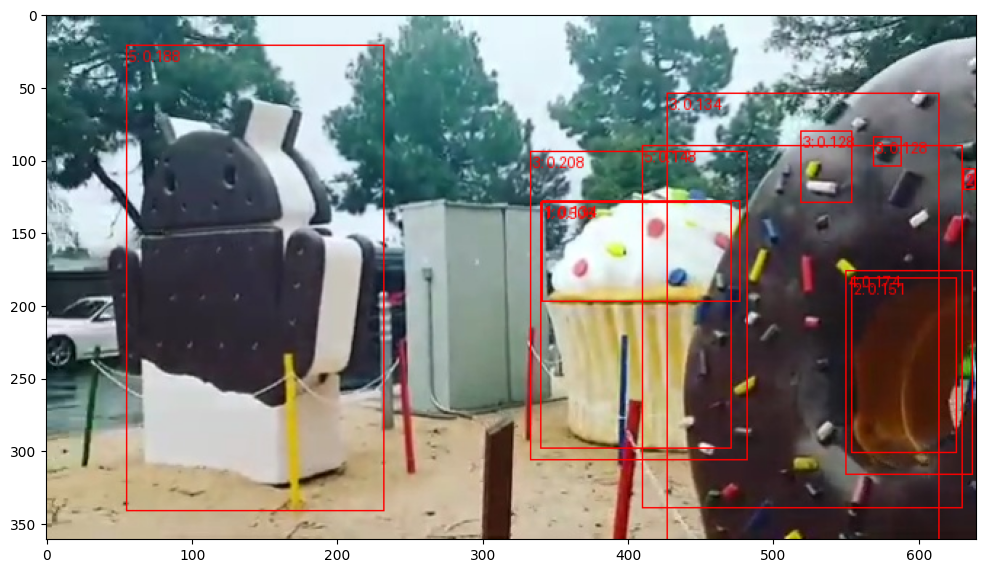

labels[0]=['1: 0.506', '3: 0.208', '5: 0.188', '4: 0.174', '2: 0.164', '2: 0.151', '5: 0.148', '3: 0.134', '1: 0.134', '3: 0.128', '3: 0.128']


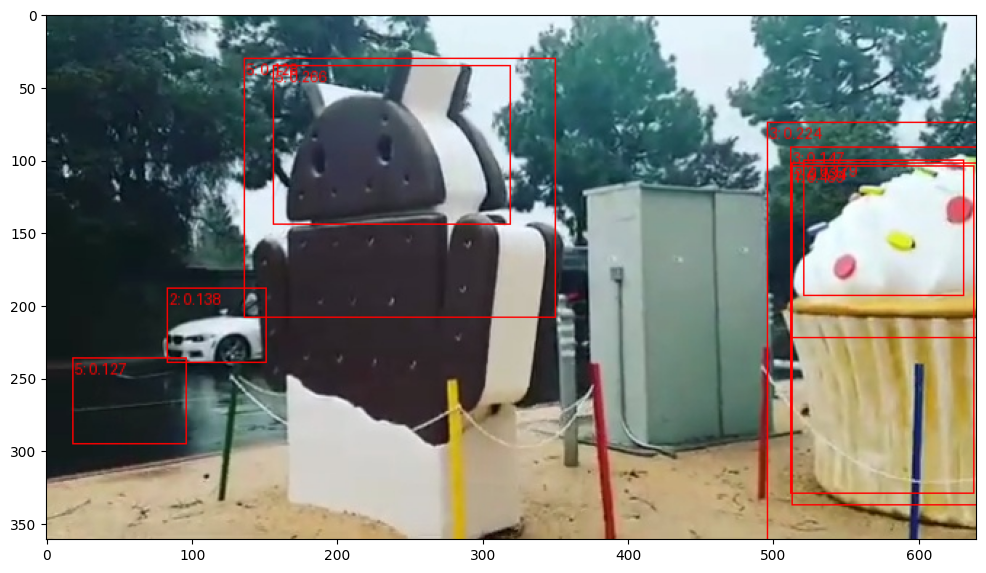

labels[1]=['1: 0.469', '5: 0.266', '3: 0.224', '2: 0.179', '3: 0.147', '2: 0.138', '2: 0.134', '5: 0.128', '5: 0.127']


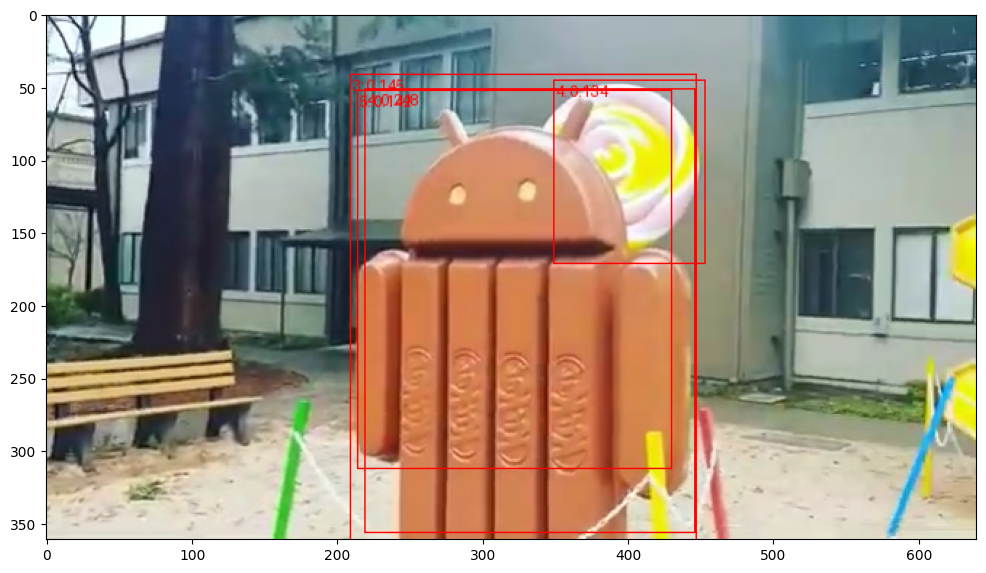

labels[2]=['4: 0.248', '3: 0.145', '5: 0.142', '4: 0.134']


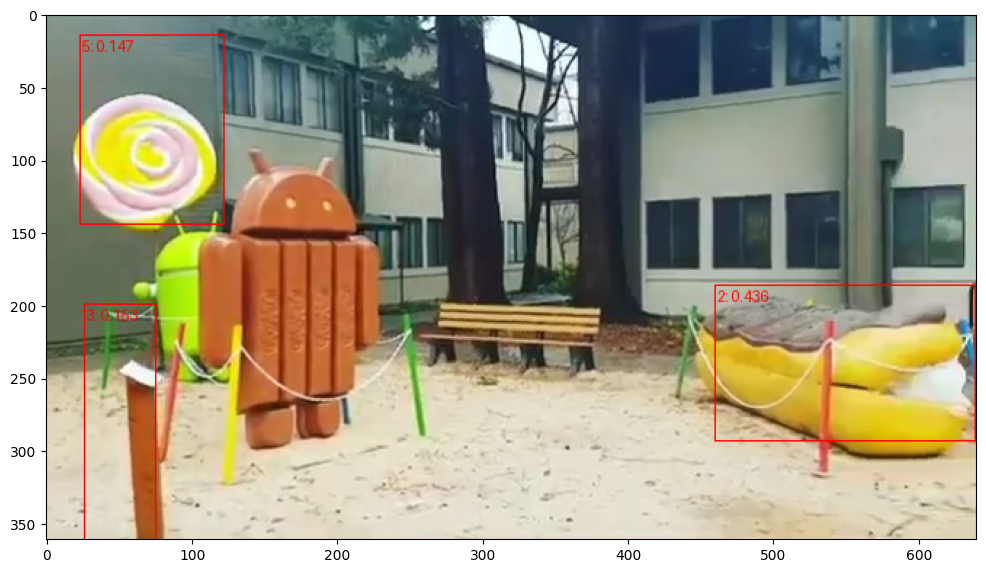

labels[3]=['2: 0.436', '3: 0.153', '5: 0.147']


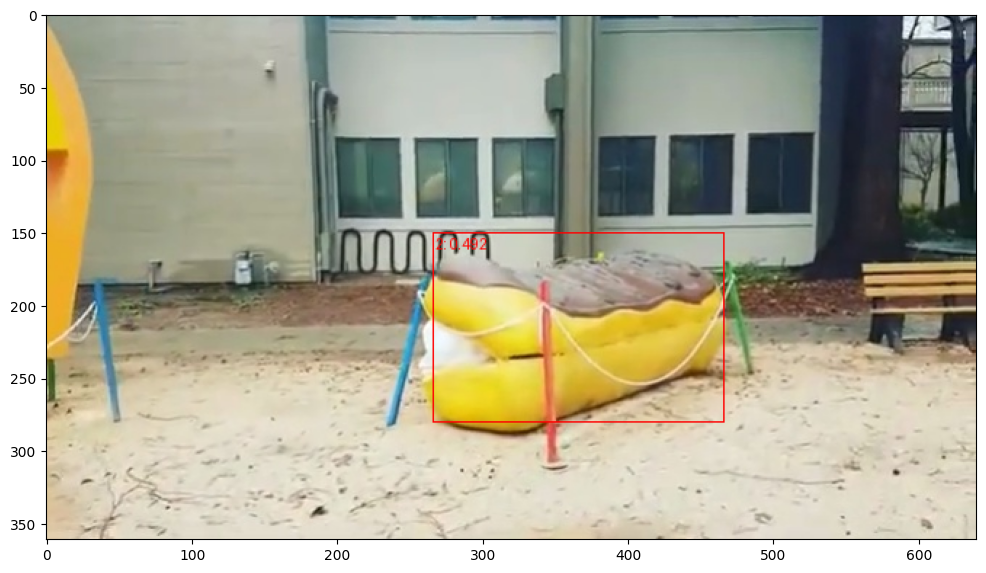

labels[4]=['2: 0.492']


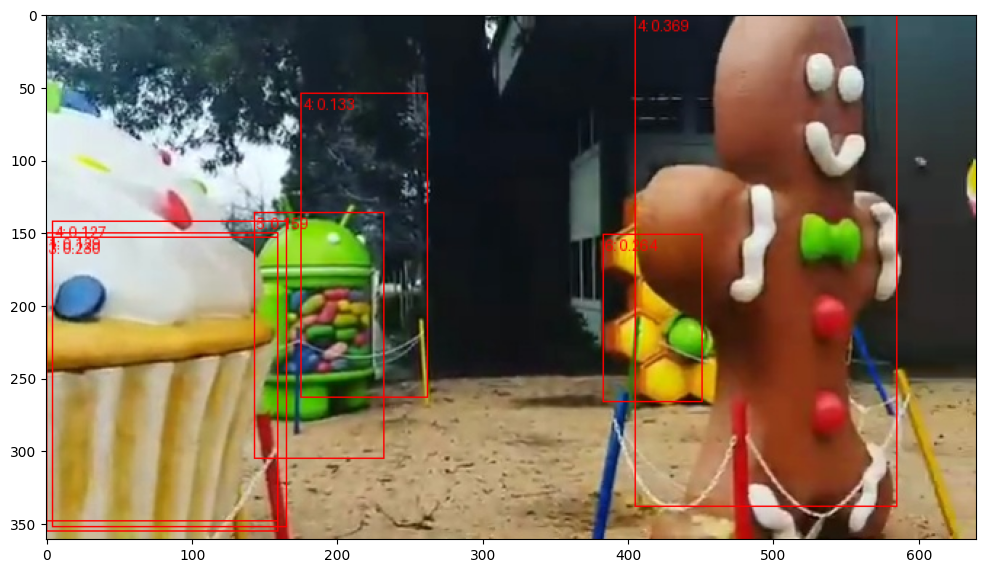

labels[5]=['4: 0.369', '6: 0.264', '3: 0.230', '5: 0.159', '4: 0.133', '1: 0.129', '4: 0.127']


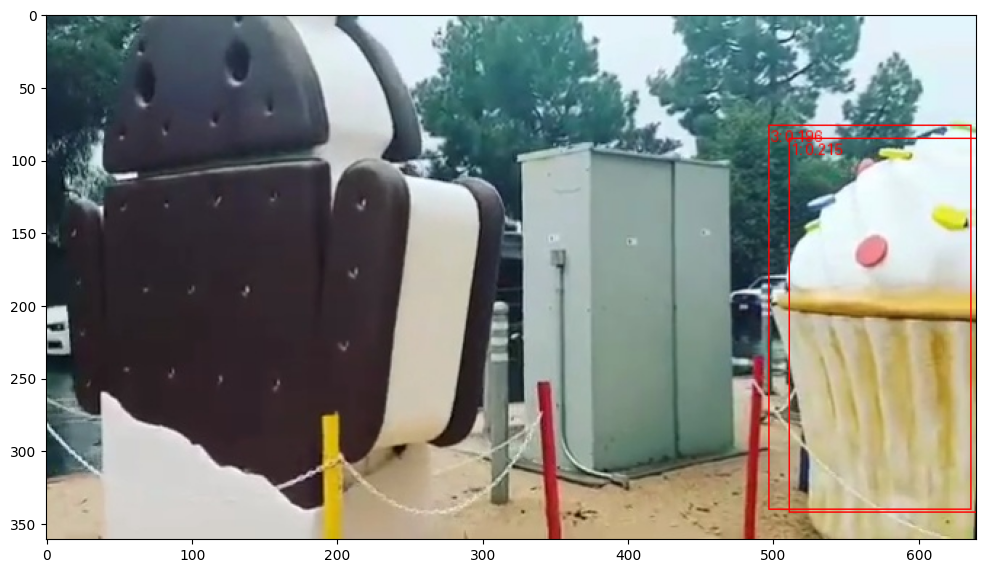

labels[6]=['1: 0.215', '3: 0.196']


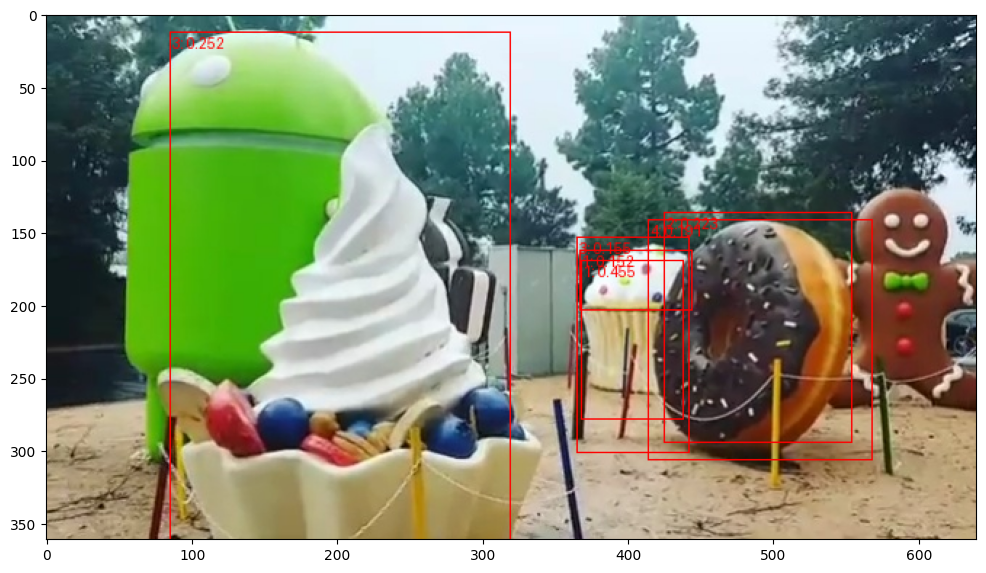

labels[7]=['1: 0.455', '3: 0.252', '2: 0.223', '4: 0.191', '3: 0.155', '1: 0.152']


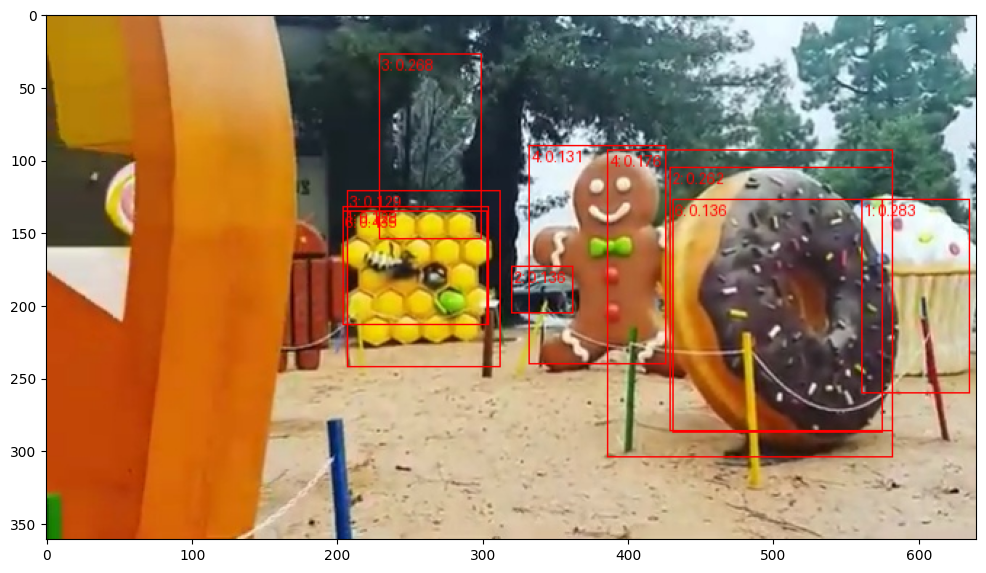

labels[8]=['6: 0.435', '1: 0.283', '3: 0.268', '2: 0.262', '4: 0.176', '6: 0.136', '2: 0.136', '4: 0.131', '3: 0.129', '1: 0.128']


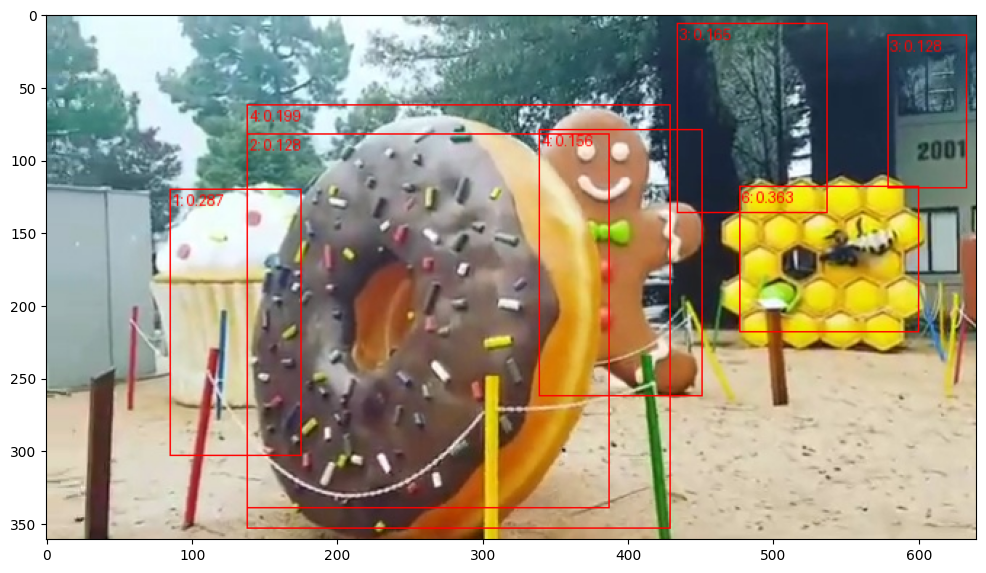

labels[9]=['6: 0.363', '1: 0.287', '4: 0.199', '3: 0.165', '4: 0.156', '2: 0.128', '3: 0.128']


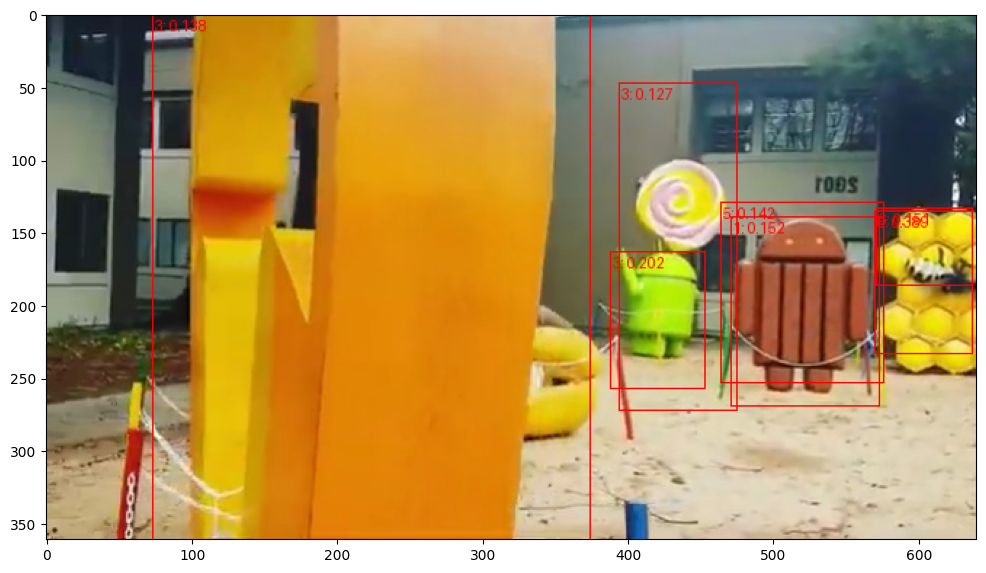

labels[10]=['6: 0.389', '3: 0.202', '1: 0.152', '6: 0.151', '5: 0.142', '3: 0.138', '3: 0.127']


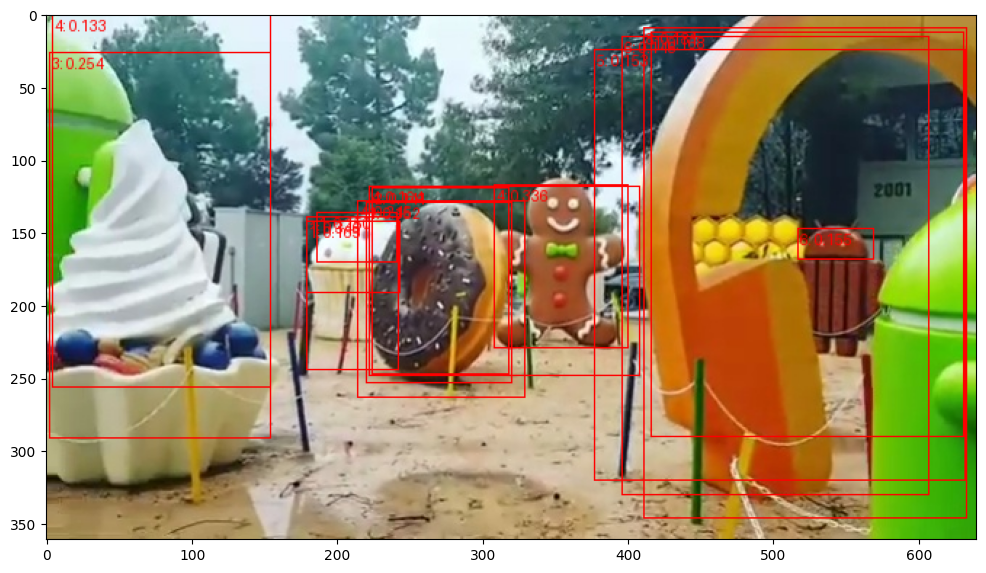

labels[11]=['1: 0.346', '4: 0.336', '3: 0.254', '4: 0.245', '1: 0.168', '1: 0.165', '4: 0.164', '6: 0.155', '5: 0.153', '1: 0.152', '1: 0.150', '6: 0.146', '2: 0.141', '4: 0.133', '8: 0.131']


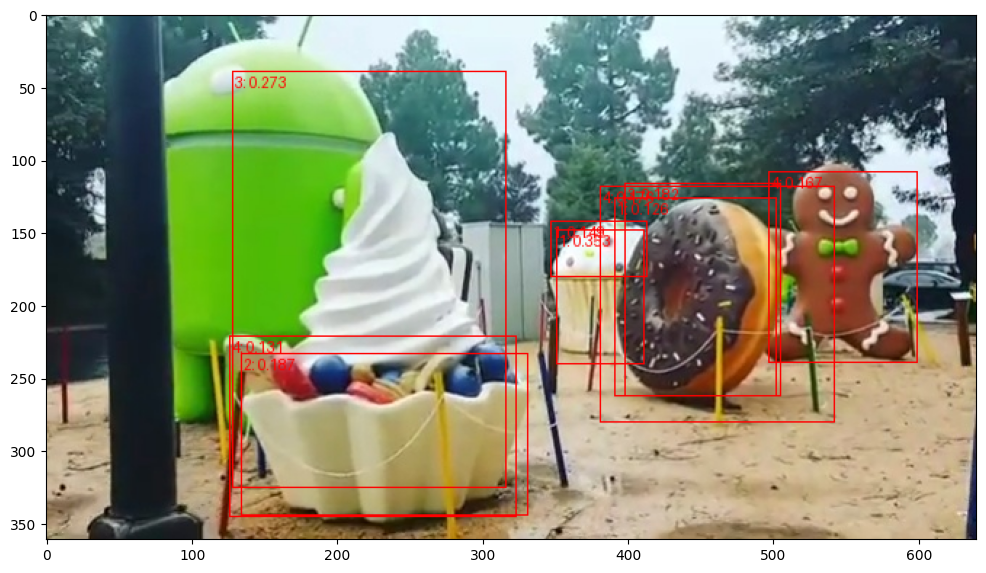

labels[12]=['1: 0.353', '3: 0.273', '2: 0.187', '2: 0.182', '4: 0.176', '4: 0.167', '1: 0.149', '4: 0.131', '1: 0.126']


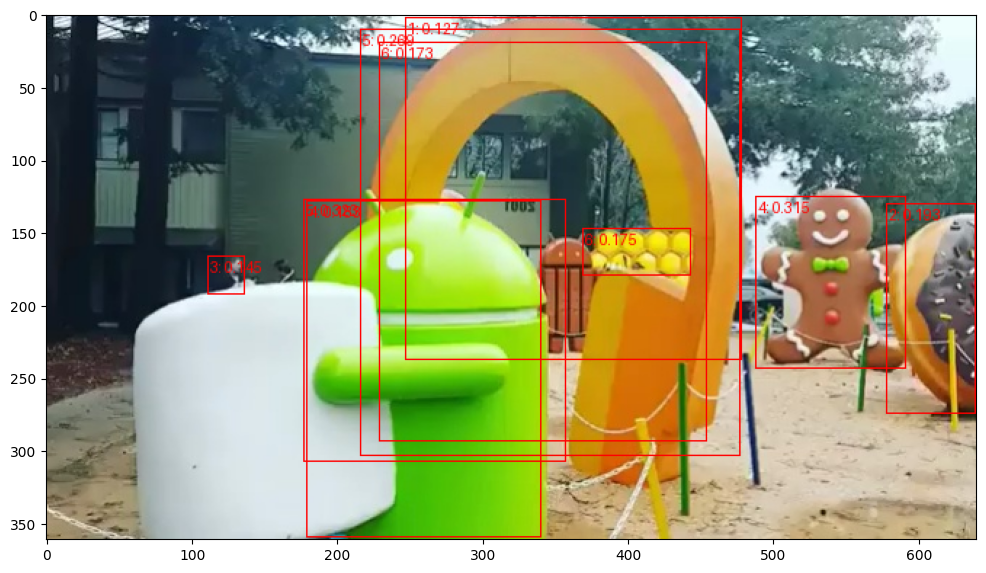

labels[13]=['5: 0.323', '4: 0.315', '5: 0.269', '2: 0.193', '4: 0.183', '6: 0.175', '6: 0.173', '3: 0.145', '1: 0.127']
done evaluating model on test frames


In [8]:
thresh = 0.125

print(f'evalulate fine-tuned model on test data.  score thresh={thresh}')

model.eval()
with torch.no_grad():
    j = 0
    for filepath in filepaths:
        image = tv_tensors.Image(read_image(filepath))
        image = transforms(image)
        images = [image.to(device)]
        # Forward pass
        prediction = model(images)
        prediction = prediction[0]
        outimg = os.path.join(module_dir, f"output_{j}.png")
        outfile = os.path.join(module_dir, f"output_{j}.txt")
        for img in images:
            image = (255.0 * (img - img.min()) / (img.max() - img.min())).to(torch.uint8)
            image = image[:3, ...]
            #_pred_labels = [f"{label}: {score:.3f}" for label, score in zip(prediction["labels"], prediction["scores"])]
            #pred_boxes = prediction["boxes"].long()
            _pred_boxes = prediction["boxes"].long()
            lines = []
            pred_labels = []
            pred_boxes = []
            for k in range(len(prediction["labels"])):
                _score = prediction["scores"][k].item()
                if _score < thresh:
                    continue
                _label = prediction["labels"][k].item()
                _cat = category_index[_label]["name"]
                _boxes = _pred_boxes[k].tolist()
                lines.append((_label, _cat, _score, _boxes[0], _boxes[1], _boxes[2], _boxes[3]))
                pred_labels.append(f"{_label}: {_score:.3f}")
                pred_boxes.append(_boxes)
            if len(pred_labels)==0:
                continue
            pred_boxes = torch.tensor(pred_boxes)
            #print(f'{j} : prediction={prediction}')
            #print(f'{j}: {len(pred_labels)}: pred_boxes={pred_boxes}')
            sorted_lines = sorted(lines, key=lambda x: (x[3], x[4], x[5], x[6]))
            output_image = draw_bounding_boxes(image, pred_boxes, pred_labels, colors="red")
            plt.figure(figsize=(12, 12))
            plt.imshow(output_image.permute(1, 2, 0))
            plt.savefig(outimg)
            plt.show()
            print(f'labels[{j}]={pred_labels}')
            
            with open(outfile, "w") as file:
                for line in sorted_lines:
                    file.write(f"{line[0]},{line[1]},{line[2]:.3f},{line[3]:.3f},{line[4]:.3f},{line[5]:.3f},{line[6]:.3f}\n")
        j+=1
        
print(f'done evaluating model on test frames')

In [10]:
#save model, load saved model, and compare results

params={'num_classes_custom' : num_classes_custom}
model_name = 'fasterrcnn_20250801_1'
model_dir = module_dir

load_pytorch_models.save(model, params, model_dir, model_name)

model2, params2 = load_pytorch_models.load_model(model_dir, model_name, device)

sample_image, sample_target = next(iter(data_loader_train))
_images1 = list(image for image in sample_image)
_targets1 = [{k: v for k, v in t.items()} for t in sample_target]
output1 = model(_images1, _targets1)
output2 = model2(_images1, _targets1)

#TODO: match the boxes, then compare the labels and scores.  a quick browse shows out1 and output2 similar


in_features=1024
